In [1]:
import os
from glob import glob
import numpy as np
import dask
import xarray as xr
import cartopy.crs as ccrs
import xgcm
from xgcm.autogenerate import generate_grid_ds
import cartopy.crs as ccrs
from cmocean import cm

from matplotlib import pyplot as plt
%matplotlib inline

from mitequinox.utils import *
from mitequinox.plot import *
from dask import compute, delayed

/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/distributed/utils.py:137: RuntimeWarning: Couldn't detect a suitable IP address for reaching '8.8.8.8', defaulting to '127.0.0.1': [Errno 101] Network is unreachable
  RuntimeWarning,


In [2]:
from dask_jobqueue import PBSCluster
cluster = PBSCluster()
#print(cluster.job_script())
#print(cluster.job_header)
w = cluster.scale(10)

In [3]:
# get dask handles and check dask server status
from dask.distributed import Client
client = Client(cluster)

In [5]:
client

Client Scheduler: tcp://10.148.0.117:41784 Dashboard: http://10.148.0.117:8787/status,Cluster Workers: 10 Cores: 140 Memory: 600.00 GB


_________
# 1. Read dataset


In [6]:
out_dir_zarr = '/home/datawork-lops-osi/equinox/mit4320/zarr/'

# read rechunked data
grid = xr.open_zarr(out_dir_zarr+'grid.zarr')
ds_KPP = xr.open_zarr(out_dir_zarr+'KPPhbl.zarr')
ds_TAUX = xr.open_zarr(out_dir_zarr+'oceTAUX.zarr')
ds_TAUY = xr.open_zarr(out_dir_zarr+'oceTAUY.zarr')

# data merge
ds = xr.merge([ds_KPP,ds_TAUX,ds_TAUY,grid])
print(ds)

<xarray.Dataset>
Dimensions:  (face: 13, i: 4320, i_g: 4320, j: 4320, j_g: 4320, k: 90, k_l: 90, k_p1: 91, k_u: 90, time: 8585)
Coordinates:
  * face     (face) int64 0 1 2 3 4 5 6 7 8 9 10 11 12
  * i        (i) int64 0 1 2 3 4 5 6 7 ... 4313 4314 4315 4316 4317 4318 4319
  * j        (j) int64 0 1 2 3 4 5 6 7 ... 4313 4314 4315 4316 4317 4318 4319
    niter    (time) int64 dask.array<chunksize=(200,), meta=np.ndarray>
  * time     (time) datetime64[ns] 2011-11-23T08:00:00 ... 2012-11-15
  * i_g      (i_g) int64 0 1 2 3 4 5 6 7 ... 4313 4314 4315 4316 4317 4318 4319
  * j_g      (j_g) int64 0 1 2 3 4 5 6 7 ... 4313 4314 4315 4316 4317 4318 4319
    CS       (face, j, i) float32 dask.array<chunksize=(1, 4320, 4320), meta=np.ndarray>
    Depth    (face, j, i) float32 dask.array<chunksize=(1, 4320, 4320), meta=np.ndarray>
    PHrefC   (k) float32 dask.array<chunksize=(90,), meta=np.ndarray>
    PHrefF   (k_p1) float32 dask.array<chunksize=(91,), meta=np.ndarray>
    SN       (face, j, i)

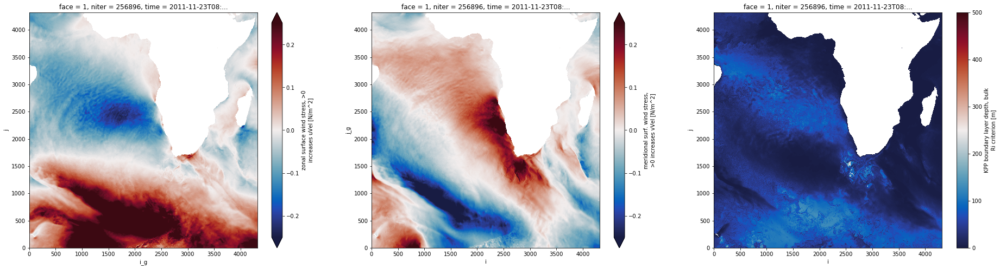

In [11]:
fig, ax = plt.subplots(figsize=(32,8))

ax = plt.subplot(131)
(ds.oceTAUX.isel(face=1,time=0)).plot(x='i_g', y='j', cmap = cm.balance, vmin=-0.25, vmax=0.25)

ax = plt.subplot(132)
(ds.oceTAUY.isel(face=1,time=0)).plot(x='i', y='j_g', cmap = cm.balance, vmin=-0.25, vmax=0.25)

ax = plt.subplot(133)
(ds.KPPhbl.isel(face=1,time=0)).plot(x='i', y='j', cmap = cm.balance, vmin=0, vmax=500)

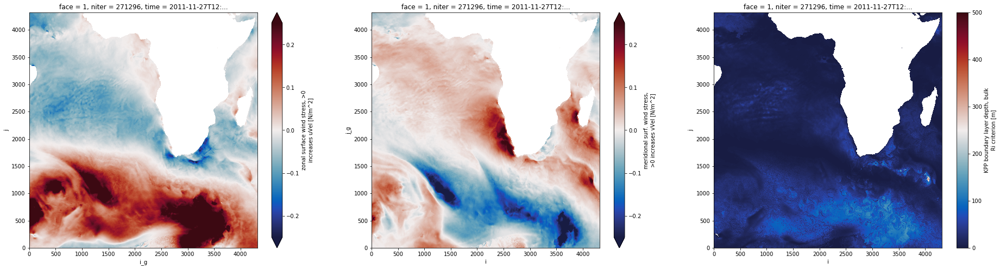

In [12]:
fig, ax = plt.subplots(figsize=(32,8))

ax = plt.subplot(131)
(ds.oceTAUX.isel(face=1,time=100)).plot(x='i_g', y='j', cmap = cm.balance, vmin=-0.25, vmax=0.25)

ax = plt.subplot(132)
(ds.oceTAUY.isel(face=1,time=100)).plot(x='i', y='j_g', cmap = cm.balance, vmin=-0.25, vmax=0.25)

ax = plt.subplot(133)
(ds.KPPhbl.isel(face=1,time=100)).plot(x='i', y='j', cmap = cm.balance, vmin=0, vmax=500)

In [7]:
def quick_llc_plot(data, axis_off=False, **kwargs):
    face_to_axis = {0: (2, 0), 1: (1, 0), 2: (0, 0),
                    3: (2, 1), 4: (1, 1), 5: (0, 1),
                    7: (0, 2), 8: (1, 2), 9: (2, 2),
                    10: (0, 3), 11: (1, 3), 12: (2, 3)}
    transpose = [7, 8, 9, 10, 11, 12]
    gridspec_kw = dict(left=0, bottom=0, right=4, top=4, wspace=0, hspace=0)
    fig, axes = plt.subplots(nrows=3, ncols=4, gridspec_kw=gridspec_kw)
    for face, (j, i) in face_to_axis.items():
        data_ax = data.isel(face=face)
        ax = axes[j,i]
        yincrease = True
        if face in transpose:
            data_ax = data_ax.transpose()
            yincrease = False
        data_ax.plot(ax=ax, yincrease=yincrease, **kwargs)
        if axis_off:
            ax.axis('off')
        ax.set_title('')

In [11]:
oceTAUX_0 =  ds.oceTAUX.rename({'i_g': 'i'}).isel(time=0)*ds.CS - ds.oceTAUY.rename({'j_g': 'j'}).isel(time=0)*ds.SN
oceTAUY_0 =  ds.oceTAUX.rename({'i_g': 'i'}).isel(time=0)*ds.SN + ds.oceTAUY.rename({'j_g': 'j'}).isel(time=0)*ds.CS

oceTAUX_100 =  ds.oceTAUX.rename({'i_g': 'i'}).isel(time=100)*ds.CS - ds.oceTAUY.rename({'j_g': 'j'}).isel(time=100)*ds.SN
oceTAUY_100 =  ds.oceTAUX.rename({'i_g': 'i'}).isel(time=100)*ds.SN + ds.oceTAUY.rename({'j_g': 'j'}).isel(time=100)*ds.CS

/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the

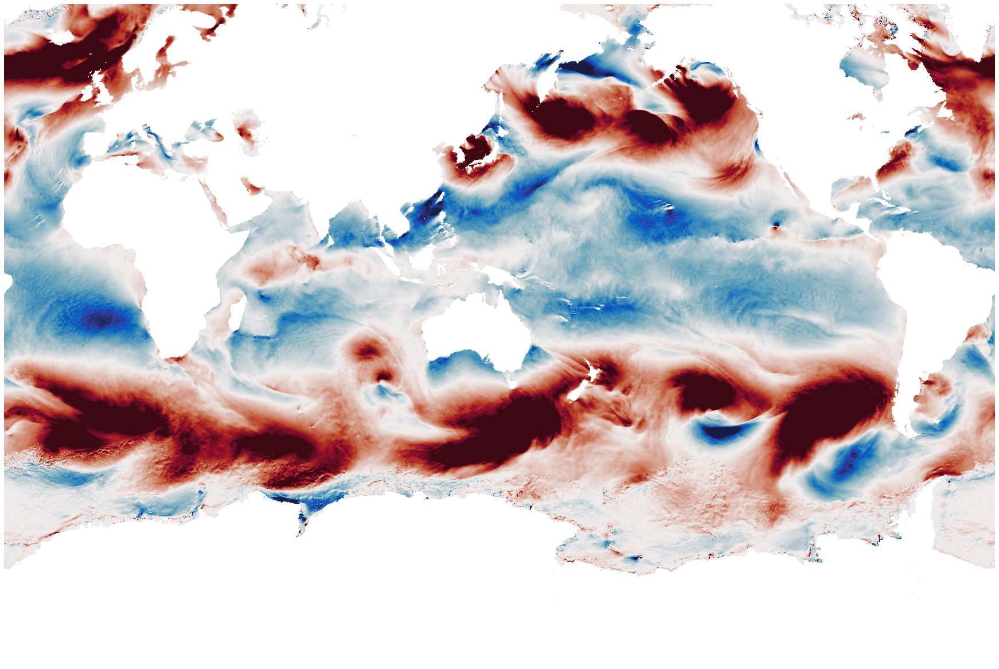

In [10]:
quick_llc_plot(oceTAUX_0, vmin=-0.25, vmax=0.25, add_colorbar=False, axis_off=True, cmap = cm.balance)

/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the

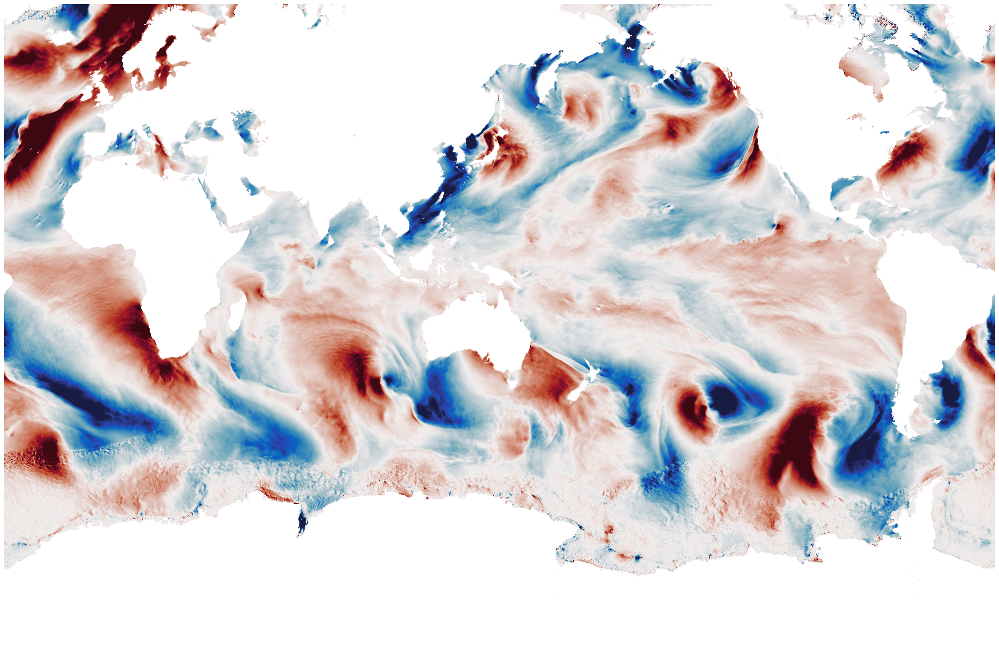

In [12]:
quick_llc_plot(oceTAUY_0, vmin=-0.25, vmax=0.25, add_colorbar=False, axis_off=True, cmap = cm.balance)

/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the

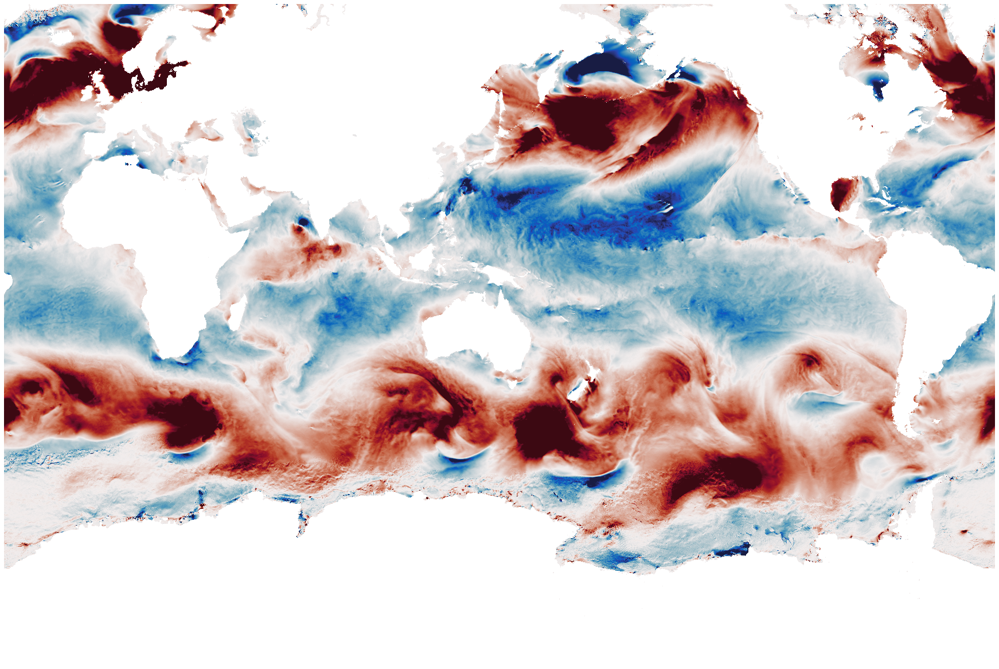

In [13]:
quick_llc_plot(oceTAUX_100, vmin=-0.25, vmax=0.25, add_colorbar=False, axis_off=True, cmap = cm.balance)

/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the

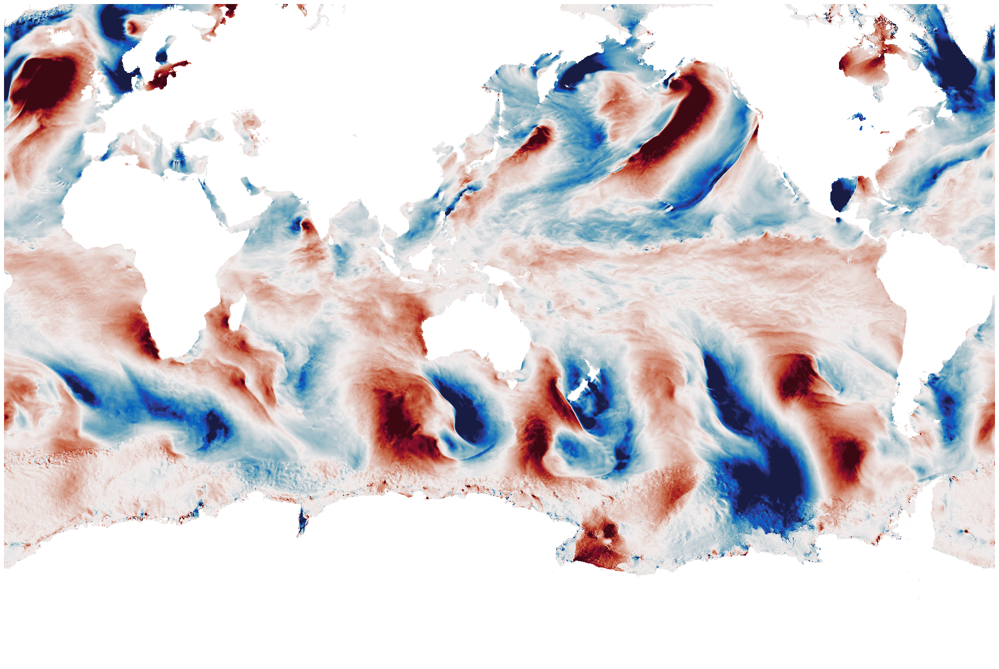

In [14]:
quick_llc_plot(oceTAUY_100, vmin=-0.25, vmax=0.25, add_colorbar=False, axis_off=True, cmap = cm.balance)

/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the

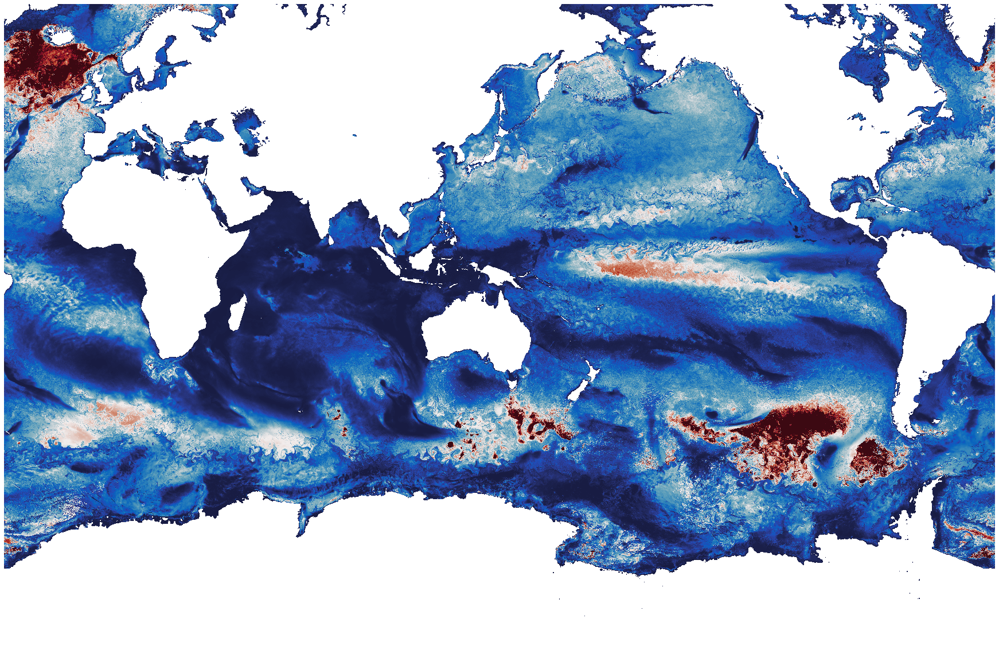

In [14]:
quick_llc_plot(ds.KPPhbl.isel(time=1), vmin=0, vmax=200, add_colorbar=False, axis_off=True, cmap = cm.balance)

# Part 1: Time series of dtau/dH

In [17]:
grid = xgcm.Grid(ds, coords={'X':{'center':'i', 'left':'i_g'},
                              'Y':{'center':'j', 'left':'j_g'}}, periodic=['X', 'Y'])

store_dir_zarr = '/home/c11-data/Test_aponte/xiaolong/TAU/'

In [16]:
# coriolis term
lat = ds['YC']
omega = 7.3/100000
f_ij = 2*omega*np.sin(np.deg2rad(lat))
f_ij

<xarray.DataArray 'YC' (face: 13, j: 4320, i: 4320)>
dask.array<mul, shape=(13, 4320, 4320), dtype=float32, chunksize=(1, 4320, 4320), chunktype=numpy.ndarray>
Coordinates:
  * face     (face) int64 0 1 2 3 4 5 6 7 8 9 10 11 12
  * i        (i) int64 0 1 2 3 4 5 6 7 ... 4313 4314 4315 4316 4317 4318 4319
  * j        (j) int64 0 1 2 3 4 5 6 7 ... 4313 4314 4315 4316 4317 4318 4319
    CS       (face, j, i) float32 dask.array<chunksize=(1, 4320, 4320), meta=np.ndarray>
    Depth    (face, j, i) float32 dask.array<chunksize=(1, 4320, 4320), meta=np.ndarray>
    SN       (face, j, i) float32 dask.array<chunksize=(1, 4320, 4320), meta=np.ndarray>
    XC       (face, j, i) float32 dask.array<chunksize=(1, 4320, 4320), meta=np.ndarray>
    YC       (face, j, i) float32 dask.array<chunksize=(1, 4320, 4320), meta=np.ndarray>
    rA       (face, j, i) float32 dask.array<chunksize=(1, 4320, 4320), meta=np.ndarray>

In [14]:
overwrite=True
    
#for face in range(13):
for face in [1]:

    Efile = store_dir_zarr+'TAUX_f%02d.zarr'%(face)

    if not os.path.isdir(Efile) or overwrite:

        oceTAUX_H =  ds.oceTAUX.isel(face=face).rename({'i_g': 'i'}).isel(j=slice(0 ,None, 4), i=slice(0, None, 4))
     
        chunks = {'i': 1080, 'j': 1080}
        oceTAUX_H = oceTAUX_H.chunk(chunks)
        
        # store
        oceTAUX_H = np.real(oceTAUX_H).rename('oceTAUX_H')
        oceTAUX_H = oceTAUX_H.to_dataset()
        print(oceTAUX_H)
        
        for c in oceTAUX_H.coords:
            try:
                del E[c].encoding['chunks']
            except:
                pass        
        
        %time oceTAUX_H.to_zarr(Efile, mode='w')

        print('--- face %d done'%face)

    else:
        print('--- face %d allready computed'%face)

<xarray.Dataset>
Dimensions:    (i: 1080, j: 1080, time: 8585)
Coordinates:
    face       int64 1
  * j          (j) int64 0 4 8 12 16 20 24 ... 4296 4300 4304 4308 4312 4316
    niter      (time) int64 dask.array<chunksize=(200,), meta=np.ndarray>
  * time       (time) datetime64[ns] 2011-11-23T08:00:00 ... 2012-11-15
  * i          (i) int64 0 4 8 12 16 20 24 ... 4296 4300 4304 4308 4312 4316
    dxC        (j, i) float32 dask.array<chunksize=(108, 108), meta=np.ndarray>
    dyG        (j, i) float32 dask.array<chunksize=(108, 108), meta=np.ndarray>
    rAw        (j, i) float32 dask.array<chunksize=(108, 108), meta=np.ndarray>
Data variables:
    oceTAUX_H  (time, j, i) float32 dask.array<chunksize=(1, 108, 108), meta=np.ndarray>


distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took

KeyboardInterrupt: 

--- face 1 done


distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)


In [19]:
overwrite=True
    
for face in range(13):
#for face in [1]:

    Efile = store_dir_zarr+'TAUX_H_f%02d.zarr'%(face)

    if not os.path.isdir(Efile) or overwrite:

        oceTAUX_H =  ds.oceTAUX.isel(face=face).rename({'i_g': 'i'}).isel(j=slice(0 ,None, 4), i=slice(0, None, 4))/ds.KPPhbl.isel(face=face,i=slice(0, None, 4),j=slice(0 ,None, 4))/1025 
     
        chunks = {'i': 1080, 'j': 1080}
        oceTAUX_H = oceTAUX_H.chunk(chunks)
        
        # store
        oceTAUX_H = np.real(oceTAUX_H).rename('oceTAUX_H')
        oceTAUX_H = oceTAUX_H.to_dataset()
        #print(oceTAUX_H)
        
        for c in oceTAUX_H.coords:
            try:
                del E[c].encoding['chunks']
            except:
                pass        
        
        %time oceTAUX_H.to_zarr(Efile, mode='w')

        print('--- face %d done'%face)

    else:
        print('--- face %d allready computed'%face)

distributed.utils_perf - WARNING - full garbage collections took 23% CPU time recently (threshold: 10%)


CPU times: user 35.2 s, sys: 1.06 s, total: 36.2 s
Wall time: 38.3 s
--- face 0 done


distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)


CPU times: user 47 s, sys: 2.22 s, total: 49.2 s
Wall time: 59.9 s
--- face 1 done


distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)


CPU times: user 40.3 s, sys: 1.28 s, total: 41.6 s
Wall time: 45.7 s
--- face 2 done


distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)


CPU times: user 30.7 s, sys: 720 ms, total: 31.4 s
Wall time: 34 s
--- face 3 done


distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)


CPU times: user 47.1 s, sys: 2.28 s, total: 49.4 s
Wall time: 1min 7s
--- face 4 done


distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)


CPU times: user 32.1 s, sys: 480 ms, total: 32.6 s
Wall time: 35 s
--- face 5 done


distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)


CPU times: user 50.6 s, sys: 1.7 s, total: 52.3 s
Wall time: 59.3 s
--- face 6 done


distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)


CPU times: user 1min 27s, sys: 3.68 s, total: 1min 30s
Wall time: 2min 59s
--- face 7 done


distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)


CPU times: user 50.4 s, sys: 2.27 s, total: 52.7 s
Wall time: 1min 4s
--- face 8 done


distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)


CPU times: user 40.4 s, sys: 1.34 s, total: 41.8 s
Wall time: 45.5 s
--- face 9 done


distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)


CPU times: user 39.6 s, sys: 1.13 s, total: 40.7 s
Wall time: 43.2 s
--- face 10 done


distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)


CPU times: user 47.7 s, sys: 1.79 s, total: 49.5 s
Wall time: 56.1 s
--- face 11 done


distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)


CPU times: user 39.2 s, sys: 1.35 s, total: 40.6 s
Wall time: 43.4 s
--- face 12 done


In [20]:
# dtau/dH

overwrite=True
    
for face in range(13):
#for face in [1]:

    Efile = store_dir_zarr+'TAUY_H_f%02d.zarr'%(face)

    if not os.path.isdir(Efile) or overwrite:

        oceTAUY_H =  ds.oceTAUY.isel(face=face).rename({'j_g': 'j'}).isel(j=slice(0 ,None, 4), i=slice(0, None, 4))/ds.KPPhbl.isel(face=face,i=slice(0, None, 4),j=slice(0 ,None, 4))/1025 
     
        chunks = {'i': 1080, 'j': 1080}
        oceTAUY_H = oceTAUY_H.chunk(chunks)
        
        # store
        oceTAUY_H = np.real(oceTAUY_H).rename('oceTAUY_H')
        oceTAUY_H = oceTAUY_H.to_dataset()
        #print(oceTAUX_H)
        
        for c in oceTAUY_H.coords:
            try:
                del E[c].encoding['chunks']
            except:
                pass        
        
        %time oceTAUY_H.to_zarr(Efile, mode='w')

        print('--- face %d done'%face)

    else:
        print('--- face %d allready computed'%face)

distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)


CPU times: user 34.9 s, sys: 864 ms, total: 35.8 s
Wall time: 38 s
--- face 0 done


distributed.utils_perf - WARNING - full garbage collections took 16% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)


CPU times: user 50 s, sys: 2.29 s, total: 52.3 s
Wall time: 1min 2s
--- face 1 done


distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)


CPU times: user 39.5 s, sys: 1.32 s, total: 40.8 s
Wall time: 45.8 s
--- face 2 done


distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)


CPU times: user 33.1 s, sys: 804 ms, total: 33.9 s
Wall time: 36.9 s
--- face 3 done


distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)


CPU times: user 1min 32s, sys: 3.83 s, total: 1min 36s
Wall time: 3min 17s
--- face 4 done


distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)


CPU times: user 31.7 s, sys: 692 ms, total: 32.4 s
Wall time: 36.4 s
--- face 5 done


distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)


CPU times: user 53.2 s, sys: 2.02 s, total: 55.2 s
Wall time: 1min 9s
--- face 6 done


distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)


CPU times: user 46.6 s, sys: 2.21 s, total: 48.8 s
Wall time: 55 s
--- face 7 done


distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)


CPU times: user 52.5 s, sys: 2.66 s, total: 55.2 s
Wall time: 1min 10s
--- face 8 done


distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)


CPU times: user 42.1 s, sys: 1.22 s, total: 43.3 s
Wall time: 48.2 s
--- face 9 done


distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)


CPU times: user 40.1 s, sys: 1.17 s, total: 41.3 s
Wall time: 44.1 s
--- face 10 done


distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)


CPU times: user 45.6 s, sys: 1.9 s, total: 47.5 s
Wall time: 59.2 s
--- face 11 done


distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)


CPU times: user 41.7 s, sys: 1.47 s, total: 43.2 s
Wall time: 51.4 s
--- face 12 done


In [6]:
store_dir_zarr = '/home/c11-data/Test_aponte/xiaolong/TAU/'
face_all = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]

D = [xr.open_zarr(store_dir_zarr+'TAUX_H_f%02d.zarr'%(face)) for face in face_all] 
ds_TAUX_H = xr.concat(D, dim='face')

D = [xr.open_zarr(store_dir_zarr+'TAUY_H_f%02d.zarr'%(face)) for face in face_all] 
ds_TAUY_H = xr.concat(D, dim='face')

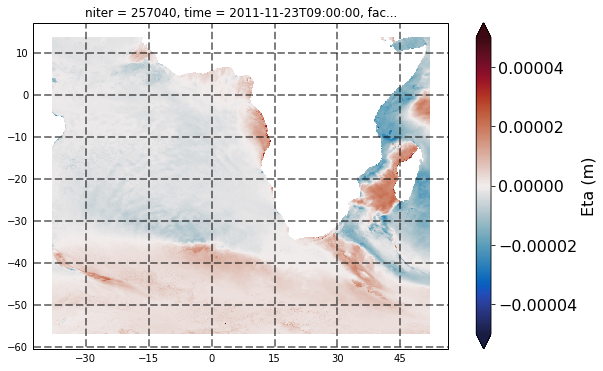

In [16]:
eta = ds_TAUX_H.oceTAUX_H.isel(face=1,time=1)

fig = plt.figure(figsize=(10,6))
ax = fig.add_subplot(111, projection=ccrs.PlateCarree())

cax = eta.plot.pcolormesh(ax=ax, x='XC', y='YC', transform=ccrs.PlateCarree(), vmin=-0.00005, vmax=0.00005, cmap = cm.balance, add_colorbar = False)
gl=ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='k', alpha=0.5, linestyle='--')
gl.xlabels_top = False
gl.ylabels_right = False

plt.ylabel('Latitude',fontsize=16)
plt.xlabel('Longitude',fontsize=16)
ax.tick_params(labelsize=16)

cbar = plt.colorbar(cax, ax=ax, extend='both', orientation='vertical')
cbar.ax.tick_params(labelsize=16)
cbar.set_label('Eta (m)', fontsize=16)
                  

In [33]:
store_dir_zarr = '/home/c11-data/Test_aponte/xiaolong/TAU/'

ds_TAUX_H  = xr.open_zarr(store_dir_zarr+'TAUX_H_f01.zarr')

In [34]:
ds = ds_TAUX_H .isel(time=slice(0,10))
ds

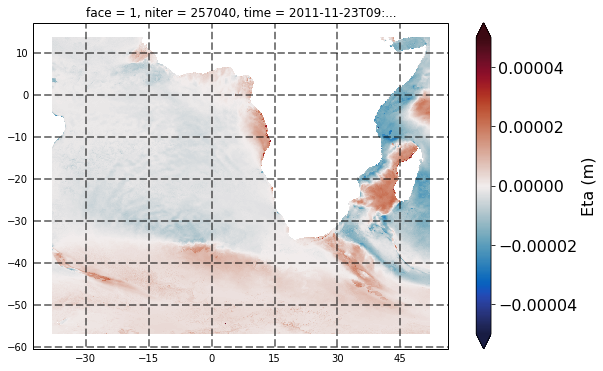

In [30]:
eta = ds_TAUX_H.oceTAUX_H.isel(time=1)

fig = plt.figure(figsize=(10,6))
ax = fig.add_subplot(111, projection=ccrs.PlateCarree())

cax = eta.plot.pcolormesh(ax=ax, x='XC', y='YC', transform=ccrs.PlateCarree(), vmin=-0.00005, vmax=0.00005, cmap = cm.balance, add_colorbar = False)
gl=ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='k', alpha=0.5, linestyle='--')
gl.xlabels_top = False
gl.ylabels_right = False

plt.ylabel('Latitude',fontsize=16)
plt.xlabel('Longitude',fontsize=16)
ax.tick_params(labelsize=16)

cbar = plt.colorbar(cax, ax=ax, extend='both', orientation='vertical')
cbar.ax.tick_params(labelsize=16)
cbar.set_label('Eta (m)', fontsize=16)
                  

In [38]:
## Southen Africa ##

face = 1
vmin, vmax = -0.00005, 0.00005

#delete all figures beforehand
figdir = datawork+'others/figs/'

lds = ds

def process(ds, i, overwrite=True):    
    
    eta = ds['oceTAUX_H']
    #print(eta)
    mtime = eta['niter'].values/86400.
    figname = figdir+'mit_Eta_f%d_t%05d' %(face, i)+'.png'
    #
    if not os.path.isfile(figname) or overwrite:
        #
        title = 'Eta'
        plot_scalar(eta, colorbar=False, title=title, savefig=figname, vmin=vmin, vmax=vmax, 
                    offline=True, coast_resolution='110m', figsize=(15,10))
        #
        m = float(eta.mean().values)
    else:
        m = -1.
    return m

#I = range(len(ds['time']))
I = range(0,10)
print(I)
values = [delayed(process)(lds.isel(time=i), i) for i in I]


range(0, 10)


In [ ]:
%time results = compute(*values)

In [23]:
%time results = compute(*values, get=client.get)

TypeError: The get= keyword has been removed.

Please use the scheduler= keyword instead with the name of
the desired scheduler like 'threads' or 'processes'

    x.compute(scheduler='single-threaded')
    x.compute(scheduler='threads')
    x.compute(scheduler='processes')

or with a function that takes the graph and keys

    x.compute(scheduler=my_scheduler_function)

or with a Dask client

    x.compute(scheduler=client)

In [15]:
store_dir_zarr = '/home/c11-data/Test_aponte/xiaolong/TAU/'
face_all = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]

D = [xr.open_zarr(store_dir_zarr+'TAUX_H_f%02d.zarr'%(face)) for face in face_all] 
ds_TAUX_H = xr.concat(D, dim='face')

D = [xr.open_zarr(store_dir_zarr+'TAUY_H_f%02d.zarr'%(face)) for face in face_all] 
ds_TAUY_H = xr.concat(D, dim='face')

In [17]:
out_dir_zarr = '/home/datawork-lops-osi/equinox/mit4320/zarr/'
grid = xr.open_zarr(out_dir_zarr+'grid.zarr')

CS = grid.CS.isel(j=slice(0 ,None, 4), i=slice(0, None, 4))
SN = grid.SN.isel(j=slice(0 ,None, 4), i=slice(0, None, 4))

In [18]:
oceTAUX_H_0 =  ds_TAUX_H.oceTAUX_H.isel(time=0)*CS - ds_TAUY_H.oceTAUY_H.isel(time=0)*SN
oceTAUY_H_0 =  ds_TAUX_H.oceTAUX_H.isel(time=0)*SN + ds_TAUY_H.oceTAUY_H.isel(time=0)*CS

oceTAUX_H_100 =  ds_TAUX_H.oceTAUX_H.isel(time=100)*CS - ds_TAUY_H.oceTAUY_H.isel(time=100)*SN
oceTAUY_H_100 =  ds_TAUX_H.oceTAUX_H.isel(time=100)*SN + ds_TAUY_H.oceTAUY_H.isel(time=100)*CS

/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the

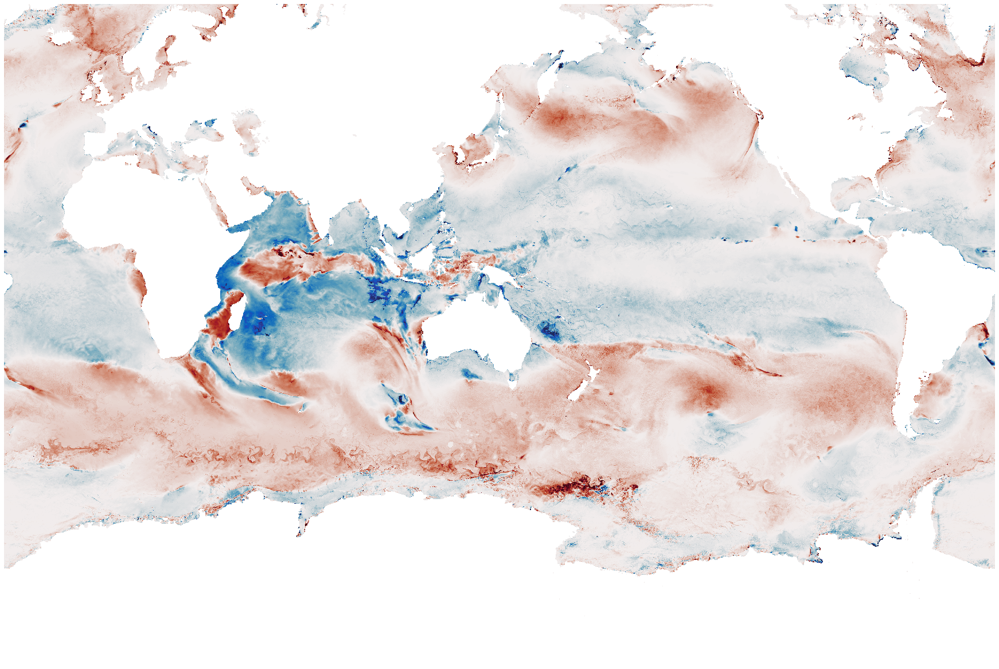

In [19]:
quick_llc_plot(oceTAUX_H_0, vmin=-0.000025, vmax=0.000025, add_colorbar=False, axis_off=True, cmap = cm.balance)

In [ ]:
quick_llc_plot(oceTAUY_H_0, vmin=-0.000025, vmax=0.000025, add_colorbar=False, axis_off=True, cmap = cm.balance)

In [ ]:
quick_llc_plot(oceTAUX_H_100, vmin=-0.000025, vmax=0.000025, add_colorbar=False, axis_off=True, cmap = cm.balance)

In [ ]:
quick_llc_plot(oceTAUY_H_100, vmin=-0.000025, vmax=0.000025, add_colorbar=False, axis_off=True, cmap = cm.balance)

________________

# Part 2: RMS


In [8]:
grid = xgcm.Grid(ds, coords={'X':{'center':'i', 'left':'i_g'},
                              'Y':{'center':'j', 'left':'j_g'}}, periodic=['X', 'Y'])

store_dir_zarr = '/home/c11-data/Test_aponte/xiaolong/TAU/'

In [18]:
# coriolis term
lat = ds['YC']
omega = 7.3/100000
f_ij = 2*omega*np.sin(np.deg2rad(lat))
f_ij

<xarray.DataArray 'YC' (face: 13, j: 4320, i: 4320)>
dask.array<mul, shape=(13, 4320, 4320), dtype=float32, chunksize=(1, 4320, 4320), chunktype=numpy.ndarray>
Coordinates:
  * face     (face) int64 0 1 2 3 4 5 6 7 8 9 10 11 12
  * i        (i) int64 0 1 2 3 4 5 6 7 ... 4313 4314 4315 4316 4317 4318 4319
  * j        (j) int64 0 1 2 3 4 5 6 7 ... 4313 4314 4315 4316 4317 4318 4319
    CS       (face, j, i) float32 dask.array<chunksize=(1, 4320, 4320), meta=np.ndarray>
    Depth    (face, j, i) float32 dask.array<chunksize=(1, 4320, 4320), meta=np.ndarray>
    SN       (face, j, i) float32 dask.array<chunksize=(1, 4320, 4320), meta=np.ndarray>
    XC       (face, j, i) float32 dask.array<chunksize=(1, 4320, 4320), meta=np.ndarray>
    YC       (face, j, i) float32 dask.array<chunksize=(1, 4320, 4320), meta=np.ndarray>
    rA       (face, j, i) float32 dask.array<chunksize=(1, 4320, 4320), meta=np.ndarray>

In [26]:
overwrite=True
    
for face in range(13):
#for face in [1]:

    Efile = store_dir_zarr+'TAUX_H_rms_f%02d.zarr'%(face)

    if not os.path.isdir(Efile) or overwrite:

        oceTAUX_H_rms = ( (ds.oceTAUX.isel(face=face).rename({'i_g': 'i'}).isel(j=slice(0 ,None, 4), i=slice(0, None, 4))/ds.KPPhbl.isel(face=face,i=slice(0, None, 4),j=slice(0 ,None, 4))/f_ij.isel(face=face,i=slice(0, None, 4),j=slice(0 ,None, 4))/1025 )**2 ).mean(['time'])
     
        chunks = {'i': 108, 'j': 108}
        oceTAUX_H_rms = oceTAUX_H_rms.chunk(chunks)
        
        # store
        oceTAUX_H_rms = np.real(oceTAUX_H_rms).rename('oceTAUX_H_rms')
        oceTAUX_H_rms = oceTAUX_H_rms.to_dataset()
        #print(oceTAUX_H_rms)
        
        for c in oceTAUX_H_rms.coords:
            try:
                del E[c].encoding['chunks']
            except:
                pass        
        
        %time oceTAUX_H_rms.to_zarr(Efile, mode='w')

        print('--- face %d done'%face)

    else:
        print('--- face %d allready computed'%face)

CPU times: user 38.5 s, sys: 1.93 s, total: 40.5 s
Wall time: 1min 2s
--- face 0 done
CPU times: user 46.9 s, sys: 2.42 s, total: 49.3 s
Wall time: 1min 18s
--- face 1 done
CPU times: user 40.8 s, sys: 1.96 s, total: 42.8 s
Wall time: 1min 7s
--- face 2 done
CPU times: user 36.9 s, sys: 1.66 s, total: 38.5 s
Wall time: 1min 1s
--- face 3 done
CPU times: user 48.8 s, sys: 2.6 s, total: 51.4 s
Wall time: 1min 24s
--- face 4 done
CPU times: user 34.6 s, sys: 1.59 s, total: 36.2 s
Wall time: 51.1 s
--- face 5 done
CPU times: user 45.3 s, sys: 2.18 s, total: 47.5 s
Wall time: 1min 10s
--- face 6 done
CPU times: user 46.5 s, sys: 2.35 s, total: 48.9 s
Wall time: 1min 16s
--- face 7 done
CPU times: user 51.2 s, sys: 2.66 s, total: 53.9 s
Wall time: 1min 30s
--- face 8 done
CPU times: user 39.6 s, sys: 1.96 s, total: 41.6 s
Wall time: 59.6 s
--- face 9 done
CPU times: user 39.4 s, sys: 1.89 s, total: 41.3 s
Wall time: 59.1 s
--- face 10 done
CPU times: user 46.4 s, sys: 2.27 s, total: 48.7 s
W

In [27]:
overwrite=True
    
for face in range(13):
#for face in [1]:

    Efile = store_dir_zarr+'TAUY_H_rms_f%02d.zarr'%(face)

    if not os.path.isdir(Efile) or overwrite:

        oceTAUY_H_rms = ( (ds.oceTAUY.isel(face=face).rename({'j_g': 'j'}).isel(j=slice(0 ,None, 4), i=slice(0, None, 4))/ds.KPPhbl.isel(face=face,i=slice(0, None, 4),j=slice(0 ,None, 4))/f_ij.isel(face=face,i=slice(0, None, 4),j=slice(0 ,None, 4))/1025 )**2 ).mean(['time'])
     
        chunks = {'i': 108, 'j': 108}
        oceTAUY_H_rms = oceTAUY_H_rms.chunk(chunks)
        
        # store
        oceTAUY_H_rms = np.real(oceTAUY_H_rms).rename('oceTAUY_H_rms')
        oceTAUY_H_rms = oceTAUY_H_rms.to_dataset()
        #print(oceTAUY_H_rms)
        
        for c in oceTAUY_H_rms.coords:
            try:
                del E[c].encoding['chunks']
            except:
                pass        
        
        %time oceTAUY_H_rms.to_zarr(Efile, mode='w')

        print('--- face %d done'%face)

    else:
        print('--- face %d allready computed'%face)

CPU times: user 37.1 s, sys: 1.59 s, total: 38.7 s
Wall time: 54.7 s
--- face 0 done
CPU times: user 48 s, sys: 2.45 s, total: 50.5 s
Wall time: 1min 21s
--- face 1 done
CPU times: user 38.9 s, sys: 2.21 s, total: 41.1 s
Wall time: 57.1 s
--- face 2 done
CPU times: user 36.3 s, sys: 1.79 s, total: 38.1 s
Wall time: 58.1 s
--- face 3 done
CPU times: user 50.5 s, sys: 2.33 s, total: 52.8 s
Wall time: 1min 27s
--- face 4 done
CPU times: user 40.1 s, sys: 1.7 s, total: 41.8 s
Wall time: 1min 6s
--- face 5 done
CPU times: user 46.4 s, sys: 2.31 s, total: 48.7 s
Wall time: 1min 13s
--- face 6 done
CPU times: user 47.1 s, sys: 2.45 s, total: 49.5 s
Wall time: 1min 14s
--- face 7 done
CPU times: user 51.2 s, sys: 3.01 s, total: 54.2 s
Wall time: 1min 28s
--- face 8 done
CPU times: user 39.9 s, sys: 1.95 s, total: 41.9 s
Wall time: 58 s
--- face 9 done
CPU times: user 40.2 s, sys: 1.77 s, total: 42 s
Wall time: 1min
--- face 10 done
CPU times: user 46.7 s, sys: 2.45 s, total: 49.2 s
Wall time: 

_________
# Read and plot RMS results

In [21]:
ds_TAUX= xr.open_zarr(store_dir_zarr+'TAUX_H_rms_f01.zarr') 
ds_TAUY= xr.open_zarr(store_dir_zarr+'TAUY_H_rms_f01.zarr') 
ds_TAUX

<xarray.Dataset>
Dimensions:        (i: 1080, j: 1080)
Coordinates:
    CS             (j, i) float32 dask.array<chunksize=(108, 108), meta=np.ndarray>
    Depth          (j, i) float32 dask.array<chunksize=(108, 108), meta=np.ndarray>
    SN             (j, i) float32 dask.array<chunksize=(108, 108), meta=np.ndarray>
    XC             (j, i) float32 dask.array<chunksize=(108, 108), meta=np.ndarray>
    YC             (j, i) float32 dask.array<chunksize=(108, 108), meta=np.ndarray>
    dxC            (j, i) float32 dask.array<chunksize=(108, 108), meta=np.ndarray>
    dyG            (j, i) float32 dask.array<chunksize=(108, 108), meta=np.ndarray>
    face           int64 ...
  * i              (i) int64 0 4 8 12 16 20 24 ... 4296 4300 4304 4308 4312 4316
  * j              (j) int64 0 4 8 12 16 20 24 ... 4296 4300 4304 4308 4312 4316
    rA             (j, i) float32 dask.array<chunksize=(108, 108), meta=np.ndarray>
    rAw            (j, i) float32 dask.array<chunksize=(108, 108), me

Text(0.5, 1.0, 'TAUY/KPP_H')

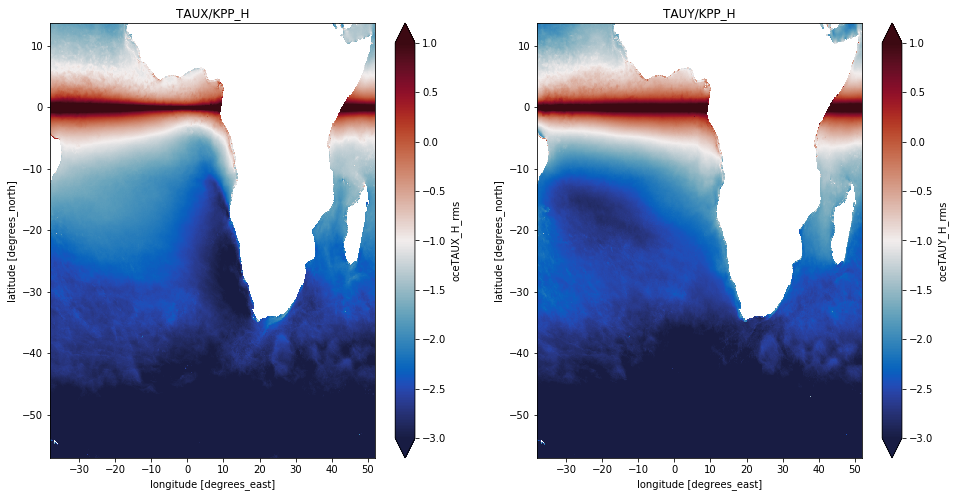

In [25]:
fig, ax = plt.subplots(figsize=(16,8))

ax = plt.subplot(121)
np.log10(ds_TAUX.oceTAUX_H_rms).plot(x='XC', y='YC', cmap = cm.balance,vmin=-3,vmax=1)
ax.set_title('TAUX/KPP_H')

ax = plt.subplot(122)
np.log10(ds_TAUY.oceTAUY_H_rms).plot(x='XC', y='YC', cmap = cm.balance,vmin=-3,vmax=1)
ax.set_title('TAUY/KPP_H')

In [28]:
store_dir_zarr = '/home/c11-data/Test_aponte/xiaolong/TAU/'
face_all = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]

D = [xr.open_zarr(store_dir_zarr+'TAUX_H_rms_f%02d.zarr'%(face)) for face in face_all] 
ds_TAUX_H = xr.concat(D, dim='face')

D = [xr.open_zarr(store_dir_zarr+'TAUY_H_rms_f%02d.zarr'%(face)) for face in face_all] 
ds_TAUY_H = xr.concat(D, dim='face')

In [30]:
def quick_llc_plot(data, axis_off=False, **kwargs):
    face_to_axis = {0: (2, 0), 1: (1, 0), 2: (0, 0),
                    3: (2, 1), 4: (1, 1), 5: (0, 1),
                    7: (0, 2), 8: (1, 2), 9: (2, 2),
                    10: (0, 3), 11: (1, 3), 12: (2, 3)}
    transpose = [7, 8, 9, 10, 11, 12]
    gridspec_kw = dict(left=0, bottom=0, right=4, top=4, wspace=0, hspace=0)
    fig, axes = plt.subplots(nrows=3, ncols=4, gridspec_kw=gridspec_kw)
    for face, (j, i) in face_to_axis.items():
        data_ax = data.isel(face=face)
        ax = axes[j,i]
        yincrease = True
        if face in transpose:
            data_ax = data_ax.transpose()
            yincrease = False
        data_ax.plot(ax=ax, yincrease=yincrease, **kwargs)
        if axis_off:
            ax.axis('off')
        ax.set_title('')

/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the

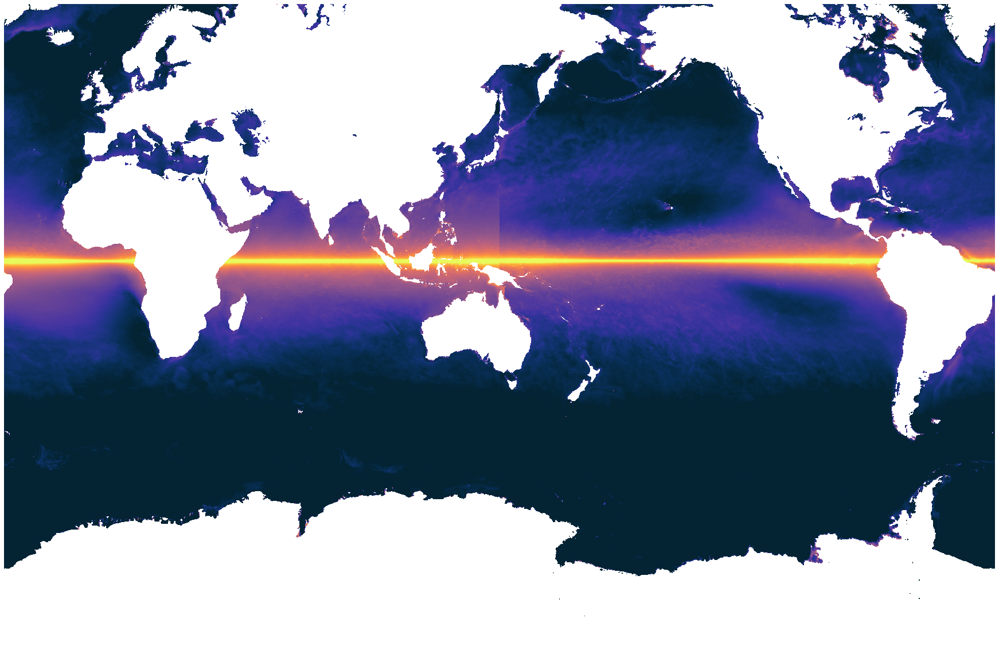

In [31]:
quick_llc_plot(np.log10(ds_TAUX_H.oceTAUX_H_rms), vmin=-3, vmax=1, add_colorbar=False, axis_off=True, cmap = cm.thermal)

/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the

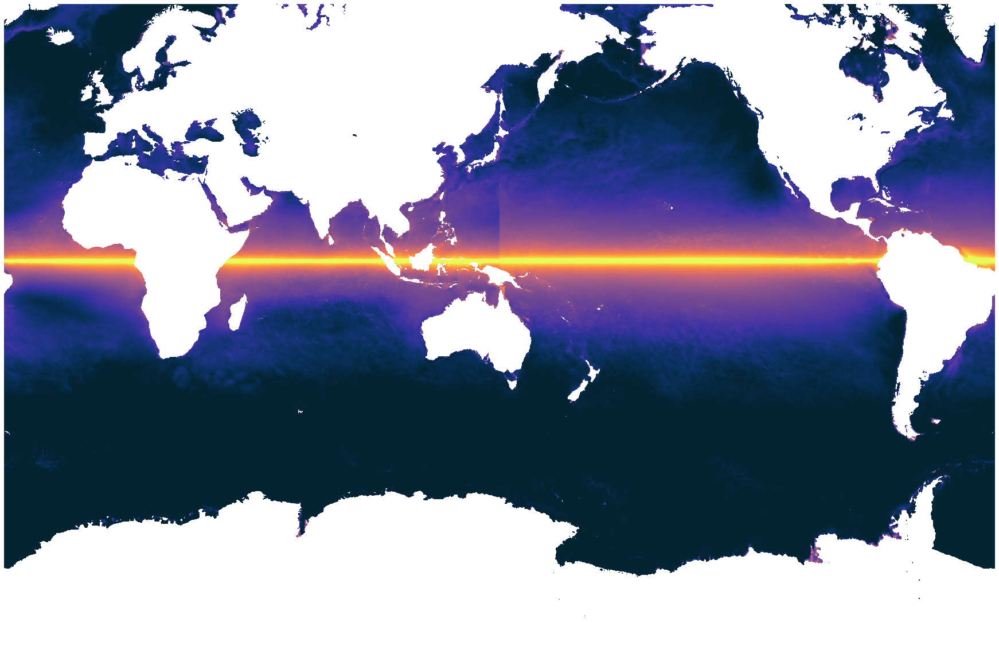

In [32]:
quick_llc_plot(np.log10(ds_TAUY_H.oceTAUY_H_rms), vmin=-3, vmax=1, add_colorbar=False, axis_off=True, cmap = cm.thermal)

/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the

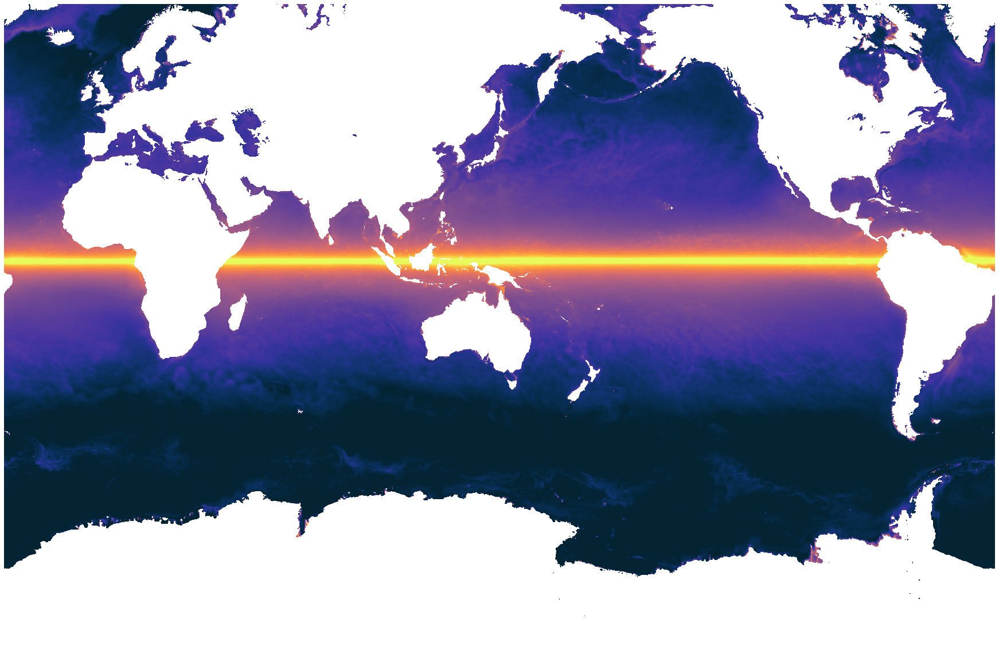

In [33]:
quick_llc_plot(np.log10(ds_TAUX_H.oceTAUX_H_rms+ds_TAUY_H.oceTAUY_H_rms), vmin=-3, vmax=1, add_colorbar=False, axis_off=True, cmap = cm.thermal)

/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: This DataArray contains multi-dimensional coordinates. In the

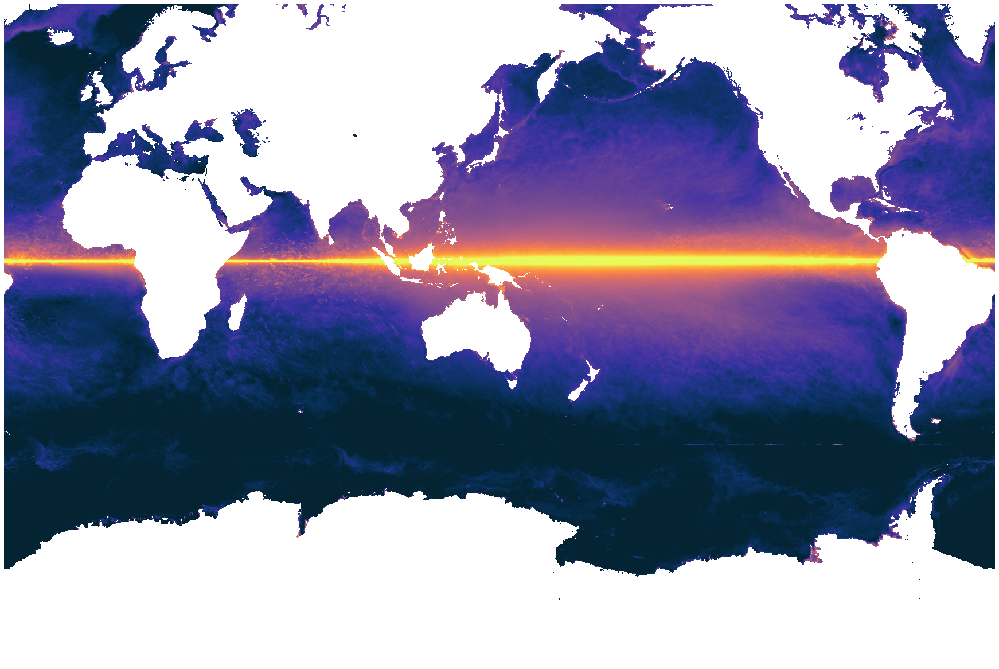

In [25]:
quick_llc_plot( np.log10( (ds_TAUX_H.oceTAUX_H_rms+ds_TAUY_H.oceTAUY_H_rms)/1025/1025/(f_ij**2) ), vmin=-3, vmax=1, add_colorbar=False, axis_off=True, cmap = cm.thermal)

In [36]:
cluster.close()

tornado.application - ERROR - Exception in callback <bound method Client._heartbeat of <Client: 'tcp://10.148.0.251:47316' processes=10 threads=140, memory=600.00 GB>>
Traceback (most recent call last):
  File "/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/tornado/ioloop.py", line 907, in _run
    return self.callback()
  File "/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/distributed/client.py", line 1081, in _heartbeat
    self.scheduler_comm.send({"op": "heartbeat-client"})
  File "/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/distributed/batched.py", line 117, in send
    raise CommClosedError
distributed.comm.core.CommClosedError
distributed.client - ERROR - Failed to reconnect to scheduler after 10.00 seconds, closing client
distributed.utils - ERROR - 
Traceback (most recent call last):
  File "/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.7/site-packages/distributed/utils.py", line 666, 